In [ ]:
!nvidia-smi

NVIDIA-SMI has failed because it couldn't communicate with the NVIDIA driver. Make sure that the latest NVIDIA driver is installed and running.



In [23]:
!pip install tf_slim

     |████████████████████████████████| 358kB 4.9MB/s 


In [15]:
import tensorflow as tf
print(tf.__version__)

2.3.0


In [3]:
!pip install pycocotools

In [16]:
%cd /content/drive/My Drive/TFOD2

/content/drive/My Drive/TFOD2


In [17]:
import os
import pathlib


if "models" in pathlib.Path.cwd().parts:
  while "models" in pathlib.Path.cwd().parts:
    os.chdir('..')
elif not pathlib.Path('models').exists():
  !git clone --depth 1 https://github.com/tensorflow/models

In [18]:
%%bash
cd models/research/
protoc object_detection/protos/*.proto --python_out=.

In [19]:
cd models/research/

/content/drive/My Drive/TFOD2/models/research


In [ ]:
!pwd

/content


In [29]:
os.getcwd()

'/content/drive/My Drive/TFOD2/models'

In [20]:
!python setup.py install

running install
running bdist_egg
running egg_info
writing object_detection.egg-info/PKG-INFO
writing dependency_links to object_detection.egg-info/dependency_links.txt
writing requirements to object_detection.egg-info/requires.txt
writing top-level names to object_detection.egg-info/top_level.txt
writing manifest file 'object_detection.egg-info/SOURCES.txt'
installing library code to build/bdist.linux-x86_64/egg
running install_lib
running build_py
copying object_detection/generate_tfrecord.py -> build/lib/object_detection
copying object_detection/protos/anchor_generator_pb2.py -> build/lib/object_detection/protos
copying object_detection/protos/argmax_matcher_pb2.py -> build/lib/object_detection/protos
copying object_detection/protos/bipartite_matcher_pb2.py -> build/lib/object_detection/protos
copying object_detection/protos/box_coder_pb2.py -> build/lib/object_detection/protos
copying object_detection/protos/box_predictor_pb2.py -> build/lib/object_detection/protos
copying object_d

In [21]:
import numpy as np
import os
import six.moves.urllib as urllib
import sys
import tarfile
import tensorflow as tf
import zipfile

from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image
from IPython.display import display

In [24]:

from object_detection.utils import ops as utils_ops
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

# patch tf1 into `utils.ops`
utils_ops.tf = tf.compat.v1

# Patch the location of gfile
tf.gfile = tf.io.gfile

In [31]:
%cd ..

/content/drive/My Drive/TFOD2


In [26]:
def load_model(model_name):
  base_url = 'http://download.tensorflow.org/models/object_detection/tf2/20200711/'
  model_file = model_name + '.tar.gz'
  model_dir = tf.keras.utils.get_file(
    fname=model_name, 
    origin=base_url + model_file,
    untar=True)

  model_dir = pathlib.Path(model_dir)/"saved_model"

  model = tf.saved_model.load(str(model_dir))

  return model

In [45]:
%cd ..

/content/drive/My Drive/TFOD2/models/research


In [46]:
# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = 'object_detection/data/mscoco_label_map.pbtxt'
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS, use_display_name=True)

In [47]:
# If you want to test the code with your images, just add path to the images to the TEST_IMAGE_PATHS.
PATH_TO_TEST_IMAGES_DIR = pathlib.Path('object_detection/test_images')
TEST_IMAGE_PATHS = sorted(list(PATH_TO_TEST_IMAGES_DIR.glob("*.jpg")))
TEST_IMAGE_PATHS

[PosixPath('object_detection/test_images/image1.jpg'),
 PosixPath('object_detection/test_images/image2.jpg')]

In [48]:
#http://download.tensorflow.org/models/object_detection/tf2/20200711/efficientdet_d0_coco17_tpu-32.tar.gz
#model_name = 'efficientdet_d1_coco17_tpu-32'
model_name= 'ssd_resnet50_v1_fpn_640x640_coco17_tpu-8'
detection_model = load_model(model_name)

244817920/244817203 [==============================] - 1s 0us/step


In [49]:
print(detection_model.signatures['serving_default'].inputs)
print(detection_model.signatures['serving_default'].output_dtypes)
print(detection_model.signatures['serving_default'].output_shapes)

[<tf.Tensor 'input_tensor:0' shape=(1, None, None, 3) dtype=uint8>, <tf.Tensor 'unknown:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_0:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_1:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_2:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_3:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_4:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_5:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_6:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_7:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_8:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_9:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_10:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_11:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_12:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_13:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_14:0' shape=<unknown> dtype=resource>, <

In [50]:

def run_inference_for_single_image(model, image):
  image = np.asarray(image)
  # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
  input_tensor = tf.convert_to_tensor(image)
  # The model expects a batch of images, so add an axis with `tf.newaxis`.
  input_tensor = input_tensor[tf.newaxis,...]

  # Run inference
  model_fn = model.signatures['serving_default']
  output_dict = model_fn(input_tensor)

  # All outputs are batches tensors.
  # Convert to numpy arrays, and take index [0] to remove the batch dimension.
  # We're only interested in the first num_detections.
  num_detections = int(output_dict.pop('num_detections'))
  output_dict = {key:value[0, :num_detections].numpy() 
                 for key,value in output_dict.items()}
  output_dict['num_detections'] = num_detections

  # detection_classes should be ints.
  output_dict['detection_classes'] = output_dict['detection_classes'].astype(np.int64)
   
  # Handle models with masks:
  if 'detection_masks' in output_dict:
    # Reframe the the bbox mask to the image size.
    detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
              output_dict['detection_masks'], output_dict['detection_boxes'],
               image.shape[0], image.shape[1])      
    detection_masks_reframed = tf.cast(detection_masks_reframed > 0.5,
                                       tf.uint8)
    output_dict['detection_masks_reframed'] = detection_masks_reframed.numpy()
    
  return output_dict

In [51]:
def show_inference(model, image_path):
  # the array based representation of the image will be used later in order to prepare the
  # result image with boxes and labels on it.
  image_np = np.array(Image.open(image_path))
  # Actual detection.
  output_dict = run_inference_for_single_image(model, image_np)
  # Visualization of the results of a detection.
  vis_util.visualize_boxes_and_labels_on_image_array(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      instance_masks=output_dict.get('detection_masks_reframed', None),
      use_normalized_coordinates=True,
      line_thickness=8)

  display(Image.fromarray(image_np))

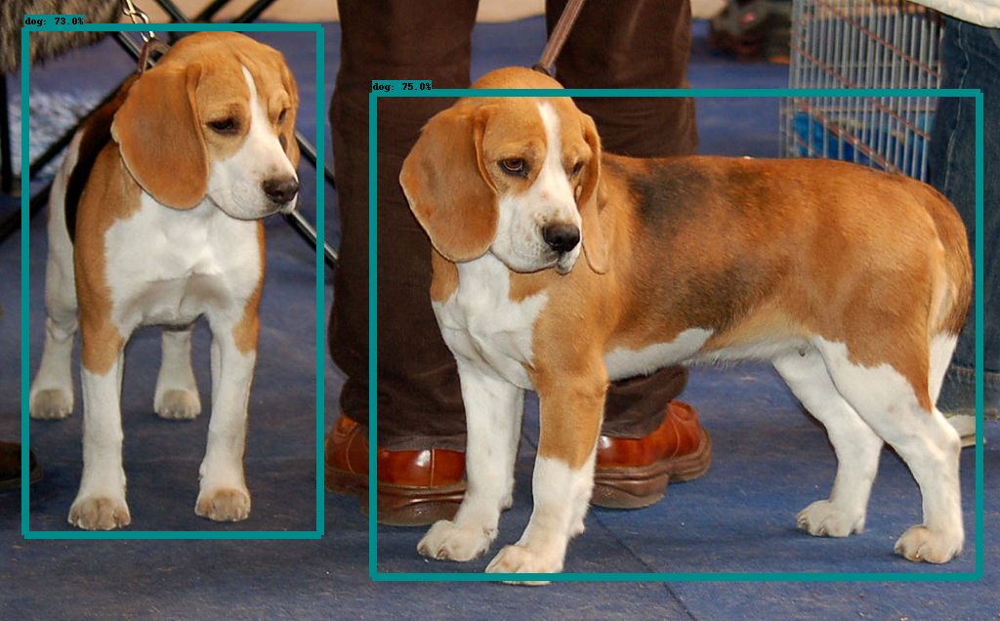

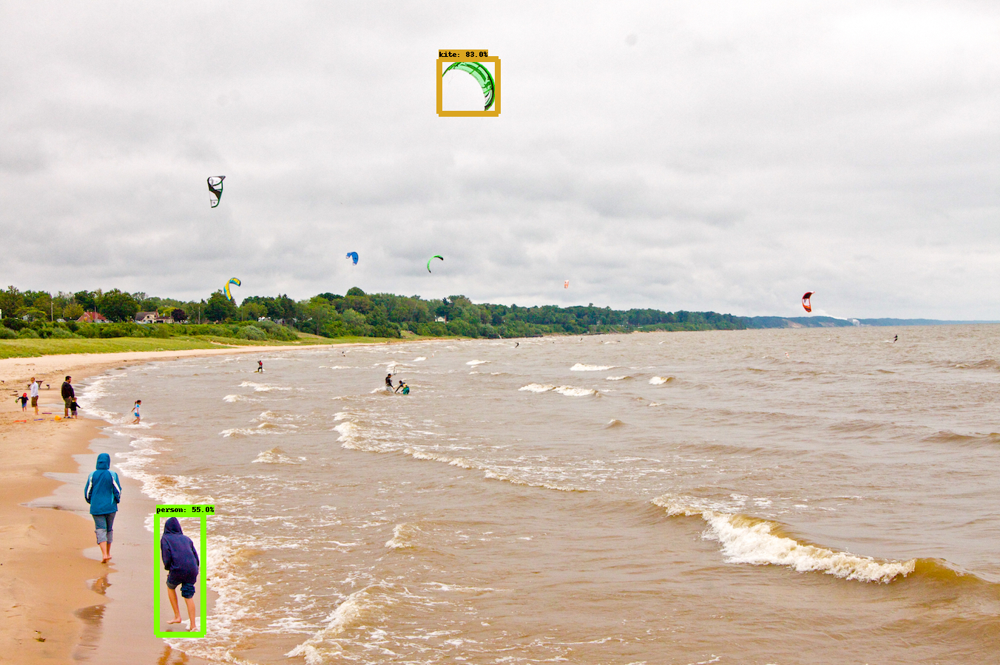

In [52]:
for image_path in TEST_IMAGE_PATHS:
  show_inference(detection_model, image_path)

In [53]:
%cd object_detection/

/content/drive/My Drive/TFOD2/models/research/object_detection


In [37]:
%cd ..

/content/drive/My Drive/TFOD2/models/research


In [54]:
import os

os.getcwd()

'/content/drive/My Drive/TFOD2/models/research/object_detection'

In [ ]:
!python xml_to_csv.py
print("Done")

Traceback (most recent call last):
  File "xml_to_csv.py", line 36, in <module>
    main()
  File "xml_to_csv.py", line 31, in main
    xml_df = xml_to_csv(image_path)
  File "xml_to_csv.py", line 10, in xml_to_csv
    tree = ET.parse(xml_file)
  File "/usr/lib/python3.6/xml/etree/ElementTree.py", line 1196, in parse
    tree.parse(source, parser)
  File "/usr/lib/python3.6/xml/etree/ElementTree.py", line 597, in parse
    self._root = parser._parse_whole(source)
KeyboardInterrupt
Done


In [41]:
!python generate_tfrecord.py --csv_input=images/train_labels.csv --image_dir=images/train --output_path=train.record

2020-10-02 15:11:26.205328: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
Successfully created the TFRecords: /content/drive/My Drive/TFOD2/models/research/object_detection/train.record


In [42]:
!python generate_tfrecord.py --csv_input=images/test_labels.csv --image_dir=images/test --output_path=test.record

2020-10-02 15:13:57.825041: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
Successfully created the TFRecords: /content/drive/My Drive/TFOD2/models/research/object_detection/test.record


In [43]:
#!wget http://download.tensorflow.org/models/object_detection/tf2/20200711/efficientdet_d1_coco17_tpu-32.tar.gz
!wget http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz

--2020-10-02 15:15:14--  http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 172.253.119.128, 2607:f8b0:4001:c23::80
Connecting to download.tensorflow.org (download.tensorflow.org)|172.253.119.128|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 244817203 (233M) [application/x-tar]
Saving to: ‘ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz’

ssd_resnet50_v1_fpn 100%[===================>] 233.48M  51.1MB/s    in 6.5s    

2020-10-02 15:15:21 (35.9 MB/s) - ‘ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz’ saved [244817203/244817203]



In [44]:
!tar -xf ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz

In [55]:
!pip install tf-models-official

     |████████████████████████████████| 849kB 4.8MB/s 
     |████████████████████████████████| 36.7MB 108kB/s 
     |████████████████████████████████| 1.1MB 43.6MB/s 
     |████████████████████████████████| 102kB 10.4MB/s 
     |████████████████████████████████| 174kB 42.8MB/s 
  Created wheel for py-cpuinfo: filename=py_cpuinfo-7.0.0-cp36-none-any.whl size=20071 sha256=d079c0c4629c15a37ce39c7bc05f8eca1ff616574546f258629d15adbc893394
  Stored in directory: /root/.cache/pip/wheels/f1/93/7b/127daf0c3a5a49feb2fecd468d508067c733fba5192f726ad1
Successfully built py-cpuinfo


In [ ]:
!python model_main_tf2.py --model_dir=training --pipeline_config_path=training/pipeline.config

2020-10-02 15:23:44.084400: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
2020-10-02 15:23:46.391306: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcuda.so.1
2020-10-02 15:23:46.400433: E tensorflow/stream_executor/cuda/cuda_driver.cc:314] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected
2020-10-02 15:23:46.400473: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (b2cceca15098): /proc/driver/nvidia/version does not exist
2020-10-02 15:23:46.406131: I tensorflow/core/platform/profile_utils/cpu_utils.cc:104] CPU Frequency: 2250000000 Hz
2020-10-02 15:23:46.406348: I tensorflow/compiler/xla/service/service.cc:168] XLA service 0x2df9480 initialized for platform Host (this does not guarantee that XLA will be used). Devices:
2020-10-02 15:23:46.406373: I tensorflow/com

In [ ]:
!python model_main_tf2.py --model_dir=training --pipeline_config_path=training/pipeline.config --checkpoint_dir=training

2020-09-26 20:06:23.656708: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
W0926 20:06:26.354885 140593327081344 model_lib_v2.py:925] Forced number of epochs for all eval validations to be 1.
INFO:tensorflow:Maybe overwriting sample_1_of_n_eval_examples: None
I0926 20:06:26.355231 140593327081344 config_util.py:552] Maybe overwriting sample_1_of_n_eval_examples: None
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I0926 20:06:26.355404 140593327081344 config_util.py:552] Maybe overwriting use_bfloat16: False
INFO:tensorflow:Maybe overwriting eval_num_epochs: 1
I0926 20:06:26.355553 140593327081344 config_util.py:552] Maybe overwriting eval_num_epochs: 1
W0926 20:06:26.355732 140593327081344 model_lib_v2.py:940] Expected number of evaluation epochs is 1, but instead encountered `eval_on_train_input_config.num_epochs` = 0. Overwriting `num_epochs` to 1.
2020-09-26 20:06:26.367569: I tensorflow/stream_executor/pl

In [42]:
%cd object_detection

/content/drive/My Drive/TFOD2/models/research/object_detection


In [57]:
### Exporting the Infernece Graph
!python exporter_main_v2.py --input_type image_tensor --pipeline_config_path training/pipeline.config --trained_checkpoint_dir training/ --output_directory exported-models/my_model

2020-10-03 05:44:58.890836: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
2020-10-03 05:45:01.111391: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcuda.so.1
2020-10-03 05:45:01.121204: E tensorflow/stream_executor/cuda/cuda_driver.cc:314] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected
2020-10-03 05:45:01.121256: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (68353d0b6f78): /proc/driver/nvidia/version does not exist
2020-10-03 05:45:01.127693: I tensorflow/core/platform/profile_utils/cpu_utils.cc:104] CPU Frequency: 2200000000 Hz
2020-10-03 05:45:01.127972: I tensorflow/compiler/xla/service/service.cc:168] XLA service 0x20e5480 initialized for platform Host (this does not guarantee that XLA will be used). Devices:
2020-10-03 05:45:01.128010: I tensorflow/com

In [58]:
!pwd

/content/drive/My Drive/TFOD2/models/research/object_detection


In [59]:
import pathlib 

def load_custom_model(model_name):
  model_file = model_name

  model_dir = pathlib.Path(model_file)/"saved_model"

  model = tf.saved_model.load(str(model_dir))

  return model

In [60]:
PATH_TO_LABELS = 'training/labelmap.pbtxt'
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS, use_display_name=True)

In [61]:
pathlib.Path

pathlib.Path

In [70]:
PATH_TO_TEST_IMAGES_DIR = pathlib.Path('images/train')
TEST_IMAGE_PATHS = sorted(list(PATH_TO_TEST_IMAGES_DIR.glob("*.jpg")))
TEST_IMAGE_PATHS

[PosixPath('images/train/bin_001.jpg'),
 PosixPath('images/train/bin_0010.jpg'),
 PosixPath('images/train/bin_0011.jpg'),
 PosixPath('images/train/bin_0012.jpg'),
 PosixPath('images/train/bin_0013.jpg'),
 PosixPath('images/train/bin_0014.jpg'),
 PosixPath('images/train/bin_0015.jpg'),
 PosixPath('images/train/bin_0016.jpg'),
 PosixPath('images/train/bin_0017.jpg'),
 PosixPath('images/train/bin_0018.jpg'),
 PosixPath('images/train/bin_0019.jpg'),
 PosixPath('images/train/bin_002.jpg'),
 PosixPath('images/train/bin_0020.jpg'),
 PosixPath('images/train/bin_0021.jpg'),
 PosixPath('images/train/bin_0022.jpg'),
 PosixPath('images/train/bin_0023.jpg'),
 PosixPath('images/train/bin_0024.jpg'),
 PosixPath('images/train/bin_0025.jpg'),
 PosixPath('images/train/bin_0026.jpg'),
 PosixPath('images/train/bin_0027.jpg'),
 PosixPath('images/train/bin_0028.jpg'),
 PosixPath('images/train/bin_0029.jpg'),
 PosixPath('images/train/bin_003.jpg'),
 PosixPath('images/train/bin_0030.jpg'),
 PosixPath('images/

In [64]:
model_name = 'exported-models/my_model'
detection_model = load_custom_model(model_name)

In [65]:
print(detection_model.signatures['serving_default'].inputs)
print(detection_model.signatures['serving_default'].output_dtypes)
print(detection_model.signatures['serving_default'].output_shapes)

[<tf.Tensor 'input_tensor:0' shape=(1, None, None, 3) dtype=uint8>, <tf.Tensor 'unknown:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_0:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_1:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_2:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_3:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_4:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_5:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_6:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_7:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_8:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_9:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_10:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_11:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_12:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_13:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_14:0' shape=<unknown> dtype=resource>, <

In [66]:
def run_inference_for_single_image(model, image):
  image = np.asarray(image)
  # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
  input_tensor = tf.convert_to_tensor(image)
  # The model expects a batch of images, so add an axis with `tf.newaxis`.
  input_tensor = input_tensor[tf.newaxis,...]

  # Run inference
  model_fn = model.signatures['serving_default']
  output_dict = model_fn(input_tensor)

  # All outputs are batches tensors.
  # Convert to numpy arrays, and take index [0] to remove the batch dimension.
  # We're only interested in the first num_detections.
  num_detections = int(output_dict.pop('num_detections'))
  output_dict = {key:value[0, :num_detections].numpy() 
                 for key,value in output_dict.items()}
  output_dict['num_detections'] = num_detections

  # detection_classes should be ints.
  output_dict['detection_classes'] = output_dict['detection_classes'].astype(np.int64)
   
  # Handle models with masks:
  if 'detection_masks' in output_dict:
    # Reframe the the bbox mask to the image size.
    detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
              output_dict['detection_masks'], output_dict['detection_boxes'],
               image.shape[0], image.shape[1])      
    detection_masks_reframed = tf.cast(detection_masks_reframed > 0.5,
                                       tf.uint8)
    output_dict['detection_masks_reframed'] = detection_masks_reframed.numpy()
    
  return output_dict

In [67]:

def show_inference(model, image_path):
  # the array based representation of the image will be used later in order to prepare the
  # result image with boxes and labels on it.
  image_np = np.array(Image.open(image_path))
  # Actual detection.
  output_dict = run_inference_for_single_image(model, image_np)
  # Visualization of the results of a detection.
  vis_util.visualize_boxes_and_labels_on_image_array(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      instance_masks=output_dict.get('detection_masks_reframed', None),
      use_normalized_coordinates=True,
      line_thickness=8)

  display(Image.fromarray(image_np))

In [69]:
image_path

PosixPath('test_images/image2.jpg')

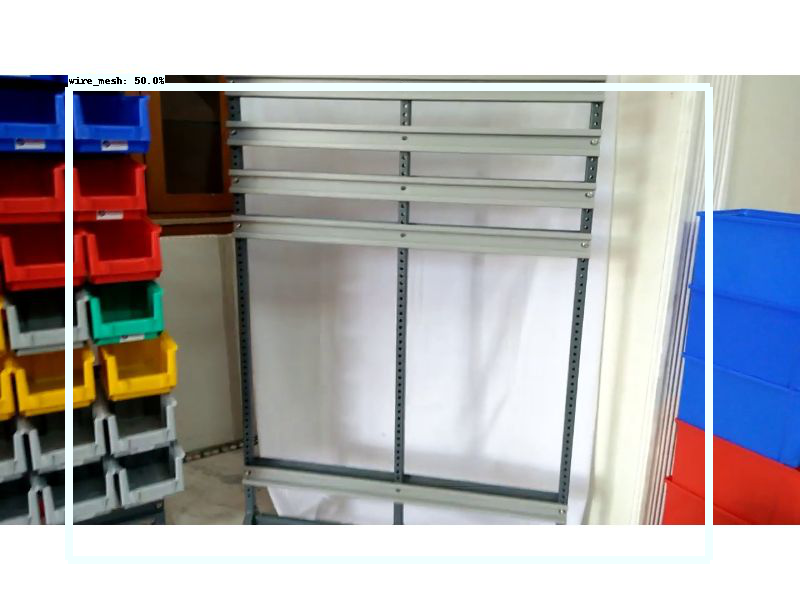

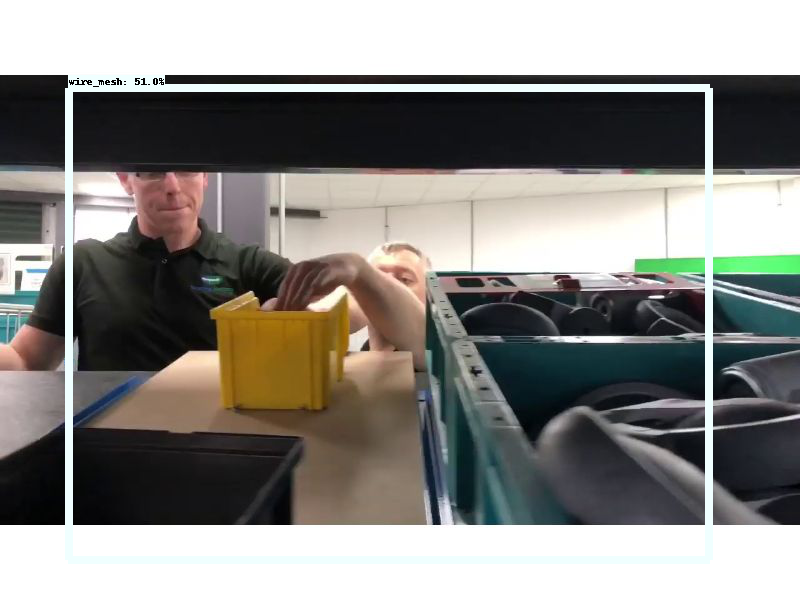

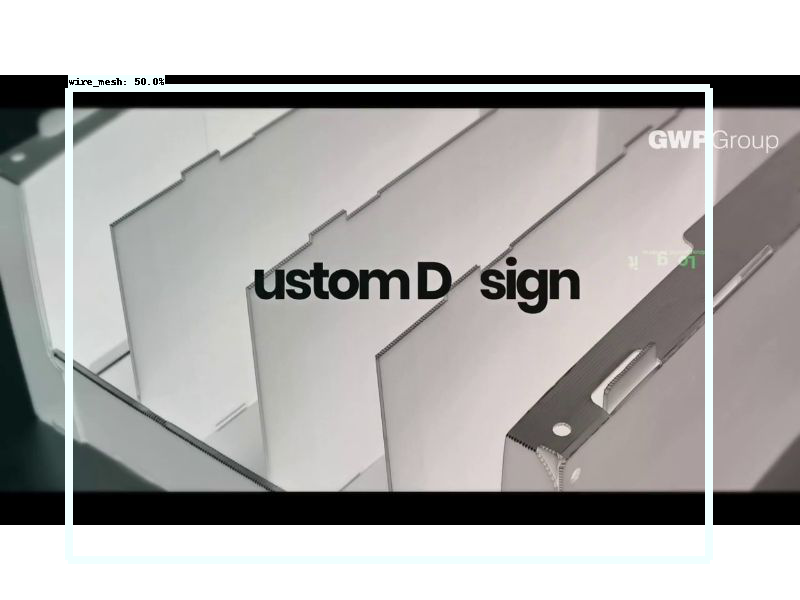

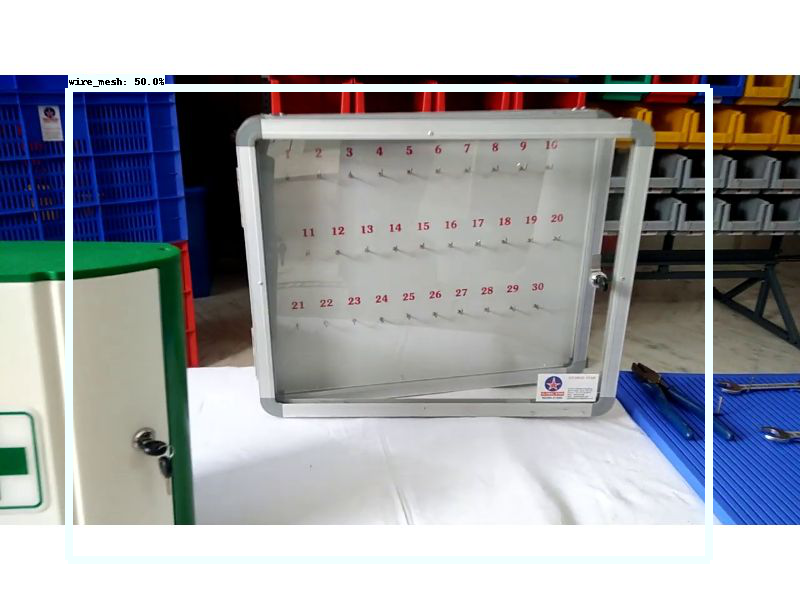

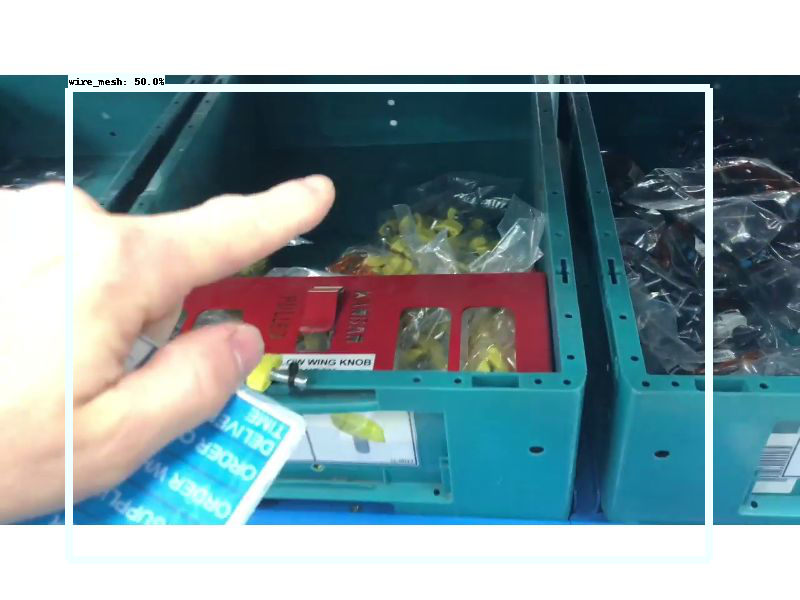

...

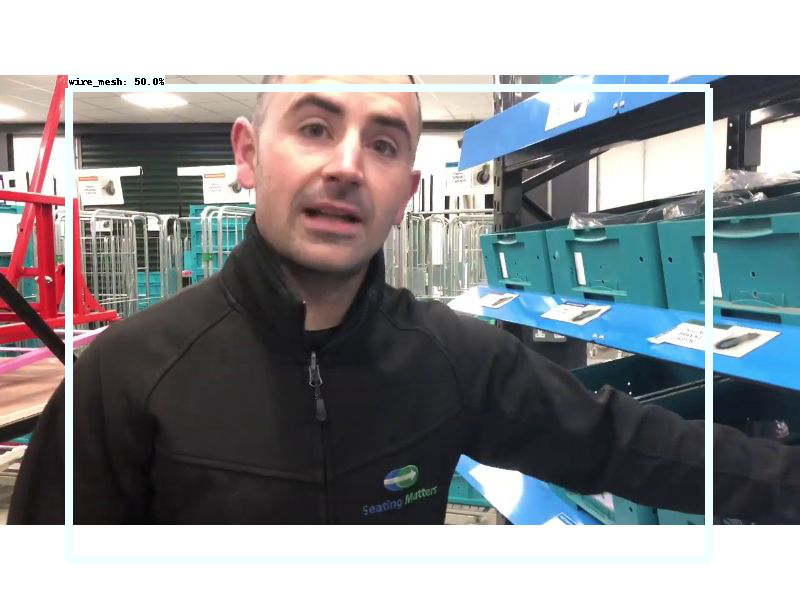

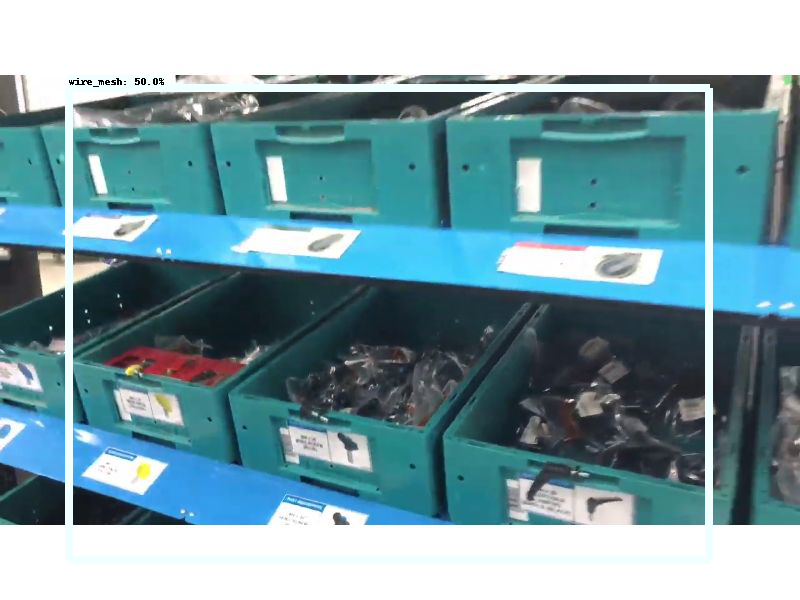

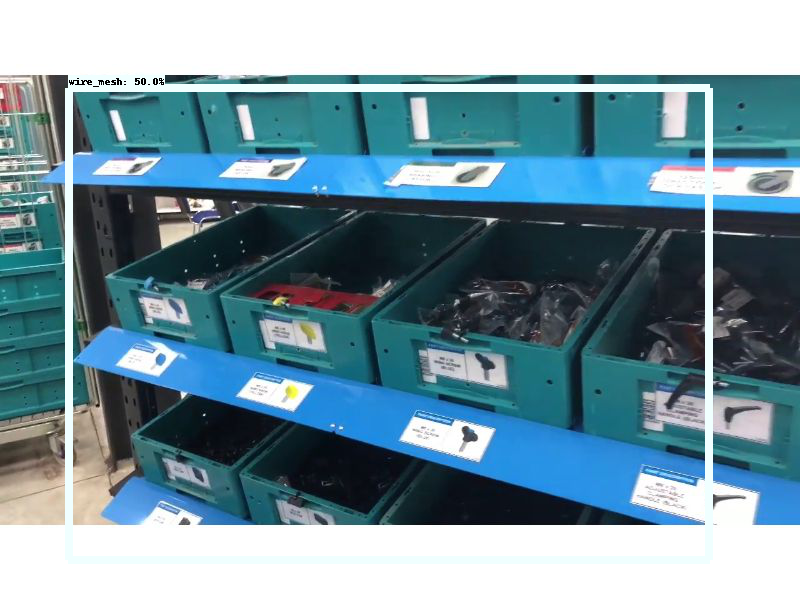

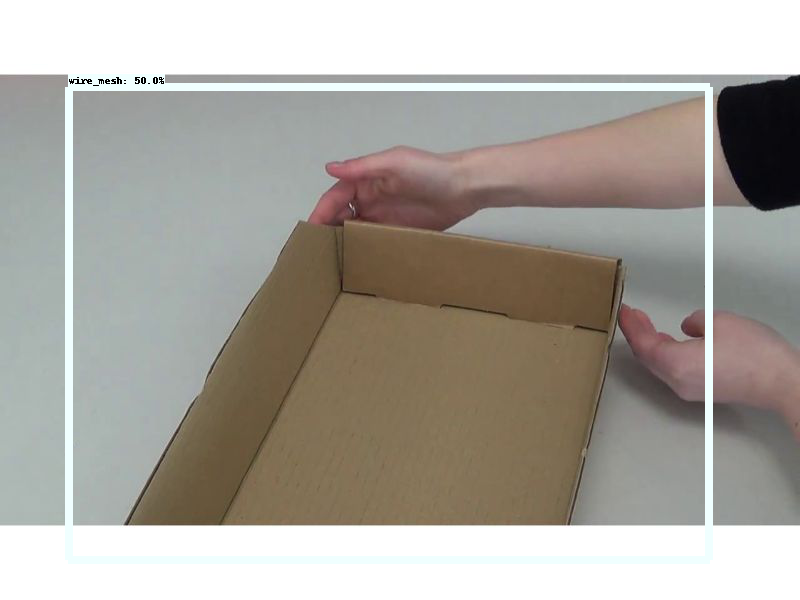

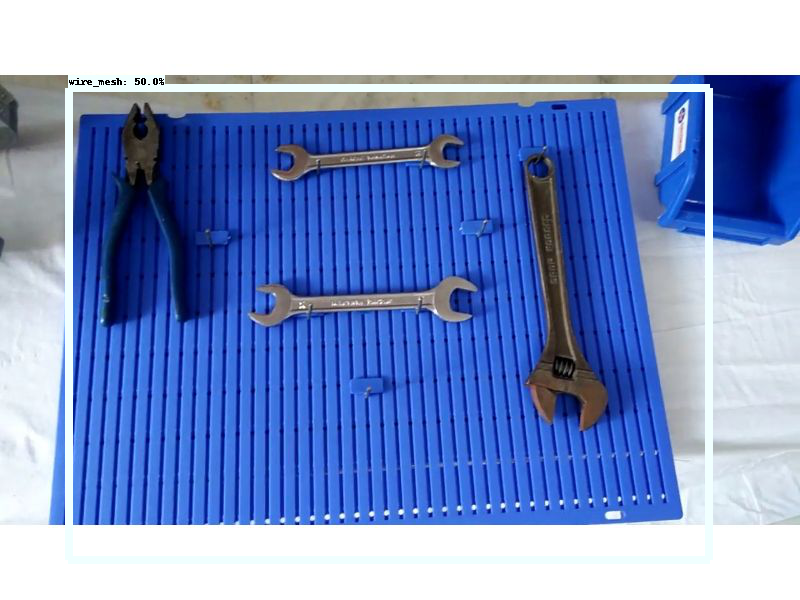

KeyboardInterrupt: ignored

In [71]:
for image_path in TEST_IMAGE_PATHS:
  show_inference(detection_model, image_path)